Segment customers of an e-commerce site
=================

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
from scipy import stats
from datetime import date,timedelta,datetime
from kmodes.kprototypes import KPrototypes
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import scipy.cluster.hierarchy as shc  
import plotly.express as px
import plotly.offline as pyoff
import plotly

from yellowbrick.cluster import KElbowVisualizer,SilhouetteVisualizer,InterclusterDistance
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics import silhouette_score
from sklearn.manifold import TSNE
import scipy.cluster.hierarchy as shc
from sklearn.metrics.cluster import adjusted_rand_score

In [2]:
customer = pd.read_csv('olist_customers_dataset.csv')
order = pd.read_csv('olist_orders_dataset.csv')
item = pd.read_csv('olist_order_items_dataset.csv')
payment = pd.read_csv('olist_order_payments_dataset.csv')

In [3]:
df = customer.merge(order, how='inner', on='customer_id')
df = df.merge(item, how='inner', on='order_id')
df = df.merge(payment, how='inner', on='order_id')

In [4]:
df.head()

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,...,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,payment_sequential,payment_type,payment_installments,payment_value
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,00e7ee1b050b8499577073aeb2a297a1,delivered,2017-05-16 15:05:35,2017-05-16 15:22:12,2017-05-23 10:47:57,...,1,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,2017-05-22 15:22:12,124.99,21.88,1,credit_card,2,146.87
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP,29150127e6685892b6eab3eec79f59c7,delivered,2018-01-12 20:48:24,2018-01-12 20:58:32,2018-01-15 17:14:59,...,1,4aa6014eceb682077f9dc4bffebc05b0,b8bc237ba3788b23da09c0f1f3a3288c,2018-01-18 20:58:32,289.00,46.48,1,credit_card,8,335.48
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP,b2059ed67ce144a36e2aa97d2c9e9ad2,delivered,2018-05-19 16:07:45,2018-05-20 16:19:10,2018-06-11 14:31:00,...,1,bd07b66896d6f1494f5b86251848ced7,7c67e1448b00f6e969d365cea6b010ab,2018-06-05 16:19:10,139.94,17.79,1,credit_card,7,157.73
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP,951670f92359f4fe4a63112aa7306eba,delivered,2018-03-13 16:06:38,2018-03-13 17:29:19,2018-03-27 23:22:42,...,1,a5647c44af977b148e0a3a4751a09e2e,7c67e1448b00f6e969d365cea6b010ab,2018-03-27 16:31:16,149.94,23.36,1,credit_card,1,173.30
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP,6b7d50bd145f6fc7f33cebabd7e49d0f,delivered,2018-07-29 09:51:30,2018-07-29 10:10:09,2018-07-30 15:16:00,...,1,9391a573abe00141c56e38d84d7d5b3b,4a3ca9315b744ce9f8e9374361493884,2018-07-31 10:10:09,230.00,22.25,1,credit_card,8,252.25


In [5]:
df.columns

Index(['customer_id', 'customer_unique_id', 'customer_zip_code_prefix',
       'customer_city', 'customer_state', 'order_id', 'order_status',
       'order_purchase_timestamp', 'order_approved_at',
       'order_delivered_carrier_date', 'order_delivered_customer_date',
       'order_estimated_delivery_date', 'order_item_id', 'product_id',
       'seller_id', 'shipping_limit_date', 'price', 'freight_value',
       'payment_sequential', 'payment_type', 'payment_installments',
       'payment_value'],
      dtype='object')

In [6]:
df.duplicated().sum()

0

In [7]:
df= df.loc[df.order_status=='delivered']

In [8]:
date_columns = ['order_purchase_timestamp','order_approved_at', 
                'order_delivered_carrier_date','order_delivered_customer_date', 
                'order_estimated_delivery_date']
for col in date_columns:
    df[col] = pd.to_datetime(df[col])
df.dtypes

customer_id                              object
customer_unique_id                       object
customer_zip_code_prefix                  int64
customer_city                            object
customer_state                           object
order_id                                 object
order_status                             object
order_purchase_timestamp         datetime64[ns]
order_approved_at                datetime64[ns]
order_delivered_carrier_date     datetime64[ns]
order_delivered_customer_date    datetime64[ns]
order_estimated_delivery_date    datetime64[ns]
order_item_id                             int64
product_id                               object
seller_id                                object
shipping_limit_date                      object
price                                   float64
freight_value                           float64
payment_sequential                        int64
payment_type                             object
payment_installments                    

In [9]:
df = df[['customer_unique_id', 'order_id', 'payment_type', 'order_delivered_carrier_date', 
         'order_purchase_timestamp' ,'order_approved_at', 'payment_value']]

In [10]:
df.isna().sum().sort_values(ascending=False)

order_approved_at               15
order_delivered_carrier_date     2
customer_unique_id               0
order_id                         0
payment_type                     0
order_purchase_timestamp         0
payment_value                    0
dtype: int64

In [11]:
df=df.dropna()

In [12]:
df.isna().sum().sort_values(ascending=False)

customer_unique_id              0
order_id                        0
payment_type                    0
order_delivered_carrier_date    0
order_purchase_timestamp        0
order_approved_at               0
payment_value                   0
dtype: int64

#### RFM dataset (feature engineering)

In this section we will create the RFM dataset, where R is the recency, F is the frequency and M is the monetary value.

In [13]:
last_date = df['order_delivered_carrier_date'].max() + timedelta(days=1)
RFM = df.groupby('customer_unique_id').agg({
    'order_delivered_carrier_date': lambda x: (last_date - x.max()).days,
    'order_id': lambda x: len(x),
    'payment_value': 'sum'
})

In [14]:
RFM.columns=['Recency', 'Frequency', 'MonetaryValue']

In [15]:
RFM.head()

,Recency,Frequency,MonetaryValue
customer_unique_id,,,
0000366f3b9a7992bf8c76cfdf3221e2,123,1,141.90
0000b849f77a49e4a4ce2b2a4ca5be3f,126,1,27.19
0000f46a3911fa3c0805444483337064,548,1,86.22
0000f6ccb0745a6a4b88665a16c9f078,333,1,43.62
0004aac84e0df4da2b147fca70cf8255,299,1,196.89


In [16]:
RFM.shape

(93342, 3)

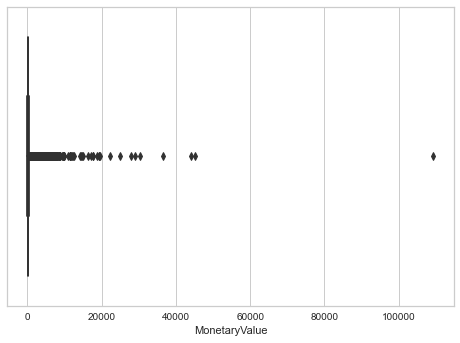

In [17]:
sns.boxplot(x=RFM['MonetaryValue']);

In [18]:
q1_mv = RFM['MonetaryValue'].quantile(0.25)
q3_mv = RFM['MonetaryValue'].quantile(0.75)
IQR = q3_mv - q1_mv
RFM = RFM[(RFM['MonetaryValue'] > q1_mv - 1.5*IQR) & (RFM['MonetaryValue'] < q3_mv + 1.5*IQR)]

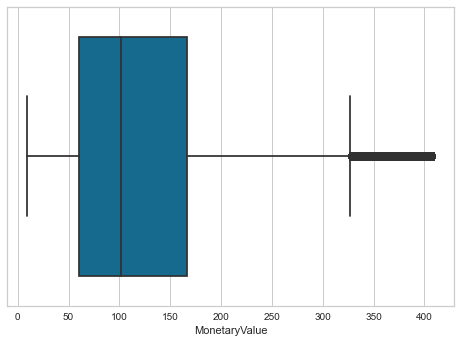

In [19]:
sns.boxplot(x=RFM['MonetaryValue']);

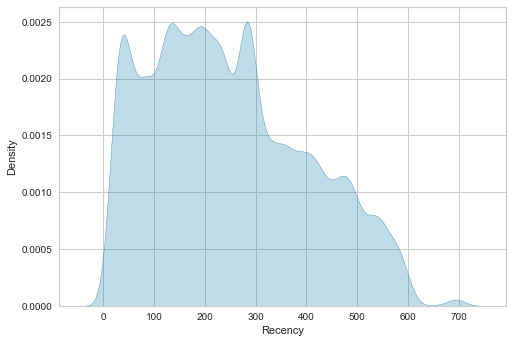

In [20]:
sns.kdeplot(x=RFM['Recency'], fill=True);

In [21]:
std = StandardScaler()
rfm_std = std.fit_transform(RFM)

In [22]:
rfm_stan = pd.DataFrame(rfm_std, columns=RFM.columns)
rfm_stan.head()

,Recency,Frequency,MonetaryValue
0,-0.823407,-0.2665,0.203034
1,-0.803693,-0.2665,-1.148154
2,1.969397,-0.2665,-0.452830
3,0.556567,-0.2665,-0.954622
4,0.333142,-0.2665,0.850771


**KMeans clustering**

k-means clustering tries to group similar kinds of items in form of clusters. It finds the similarity between the items and groups them into the clusters. K-means clustering algorithm works in three steps. 

* Select the k values.
* Initialize the centroids.
* Select the group and find the average.

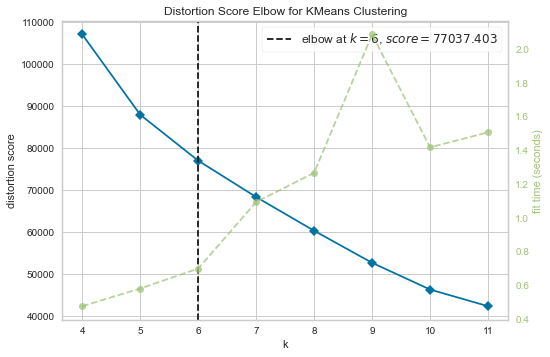

In [23]:
model = KMeans()
visualizer = KElbowVisualizer(model, k=(4,12))

visualizer.fit(rfm_std)        # Fit the data to the visualizer
visualizer.show(); 

So 6 is the optimal number of cluster

In [24]:
model_k = KMeans(n_clusters=6)
kmeans = model_k.fit(rfm_std)

In [25]:
kmeans.cluster_centers_.shape

(6, 3)

In [26]:
RFM['kmcluster'] = kmeans.labels_
RFM.head()

,Recency,Frequency,MonetaryValue,kmcluster
customer_unique_id,,,,
0000366f3b9a7992bf8c76cfdf3221e2,123,1,141.90,5
0000b849f77a49e4a4ce2b2a4ca5be3f,126,1,27.19,0
0000f46a3911fa3c0805444483337064,548,1,86.22,4
0000f6ccb0745a6a4b88665a16c9f078,333,1,43.62,4
0004aac84e0df4da2b147fca70cf8255,299,1,196.89,5


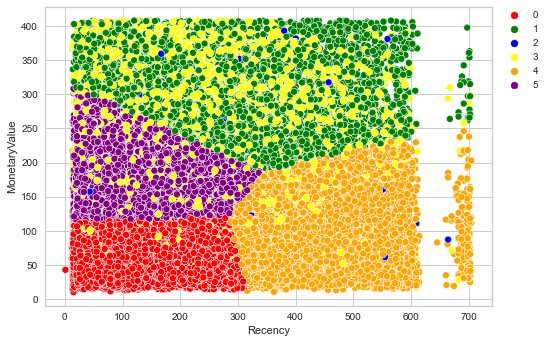

In [27]:
sns.scatterplot(data=RFM, x="Recency", y="MonetaryValue", hue="kmcluster", 
                palette=['red', 'green', 'blue', 'yellow', 'orange', 'purple'])
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0);

In [28]:
px.scatter_3d(RFM, x='Recency',y='Frequency', z='MonetaryValue', color='kmcluster')

In [29]:
n_clusters = kmeans.labels_
pd.Series(n_clusters).value_counts()

0    30775
4    22132
5    16407
3     7868
1     6822
2      194
dtype: int64

In [30]:
kmeans_score = silhouette_score(rfm_std, kmeans.labels_, metric='euclidean')
round(kmeans_score,4)

0.3522

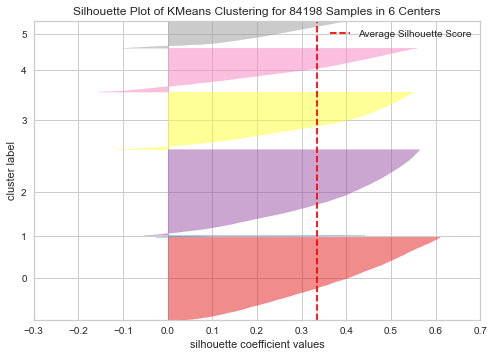

In [31]:
model = KMeans(n_clusters=6)
visualizer = SilhouetteVisualizer(model)

visualizer.fit(rfm_std)    # Fit the data to the visualizer
visualizer.poof();    # Draw/show/poof the data

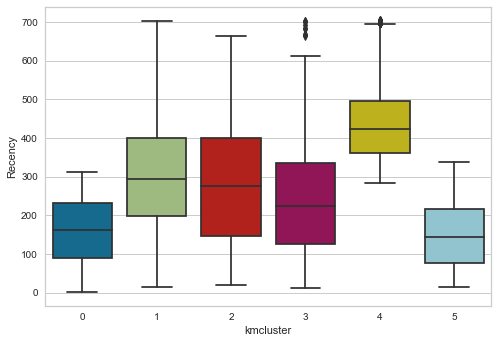

In [32]:
sns.boxplot(x='kmcluster', y='Recency', data=RFM);

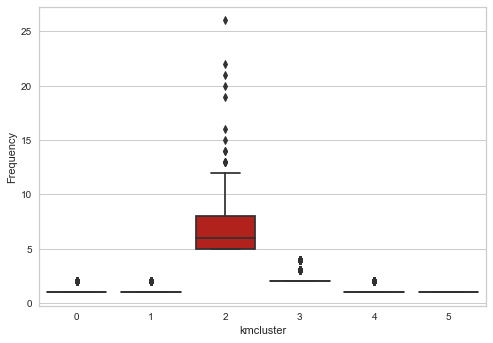

In [33]:
sns.boxplot(x='kmcluster', y='Frequency', data=RFM);

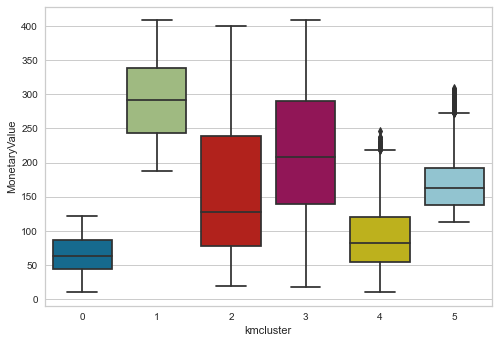

In [34]:
sns.boxplot(x='kmcluster', y='MonetaryValue', data=RFM);

In [35]:
RFM[RFM.kmcluster==0].describe()

,Recency,Frequency,MonetaryValue,kmcluster
count,30775.000000,30775.000000,30775.000000,30775.0
mean,159.905508,1.010658,65.328543,0.0
std,83.452428,0.102688,26.012089,0.0
min,1.000000,1.000000,9.590000,0.0
25%,89.000000,1.000000,43.465000,0.0
50%,162.000000,1.000000,63.270000,0.0
75%,231.000000,1.000000,86.360000,0.0
max,312.000000,2.000000,121.090000,0.0


In [36]:
RFM[RFM.kmcluster==1].describe()

,Recency,Frequency,MonetaryValue,kmcluster
count,6822.000000,6822.000000,6822.000000,6822.0
mean,301.773087,1.011434,293.068931,1.0
std,139.004261,0.106323,56.965193,0.0
min,14.000000,1.000000,186.950000,1.0
25%,197.000000,1.000000,243.760000,1.0
50%,294.000000,1.000000,291.400000,1.0
75%,401.000000,1.000000,338.547500,1.0
max,702.000000,2.000000,408.660000,1.0


In [37]:
RFM[RFM.kmcluster==2].describe()

,Recency,Frequency,MonetaryValue,kmcluster
count,194.000000,194.000000,194.000000,194.0
mean,277.381443,7.247423,162.093763,2.0
std,158.090283,3.348593,104.390321,0.0
min,20.000000,5.000000,19.000000,2.0
25%,146.000000,5.000000,77.097500,2.0
50%,274.500000,6.000000,127.770000,2.0
75%,398.750000,8.000000,239.425000,2.0
max,664.000000,26.000000,399.810000,2.0


In [38]:
RFM[RFM.kmcluster==3].describe()

,Recency,Frequency,MonetaryValue,kmcluster
count,7868.000000,7868.000000,7868.000000,7868.0
mean,238.619344,2.171327,215.167434,3.0
std,140.214896,0.463084,93.656750,0.0
min,12.000000,2.000000,17.380000,3.0
25%,126.000000,2.000000,139.812500,3.0
50%,223.000000,2.000000,208.220000,3.0
75%,334.250000,2.000000,289.985000,3.0
max,703.000000,4.000000,408.700000,3.0


#### PCA  Analysis for  K-Means

In [39]:
pca=PCA(n_components=2)
principal_comp=pca.fit_transform(rfm_std)
principal_comp

array([[-0.05306269, -0.84502029],
       [-1.00791272, -0.74606622],
       [-0.48927476,  1.97864701],
       ...,
       [-0.26868317,  2.17676934],
       [-0.12083737, -0.78036483],
       [-0.61467785,  1.64800608]])

In [40]:
pca_df=pd.DataFrame(data=principal_comp,columns=['pca1','pca2'])
pca_df.head()

,pca1,pca2
0,-0.053063,-0.845020
1,-1.007913,-0.746066
2,-0.489275,1.978647
3,-0.857793,0.599122
4,0.416100,0.270359


In [41]:
RFM.reset_index(inplace=True) 

In [42]:
pca_df=pd.concat([pca_df, RFM['kmcluster']],axis=1)
pca_df.head()

,pca1,pca2,kmcluster
0,-0.053063,-0.845020,5
1,-1.007913,-0.746066,0
2,-0.489275,1.978647,4
3,-0.857793,0.599122,4
4,0.416100,0.270359,5


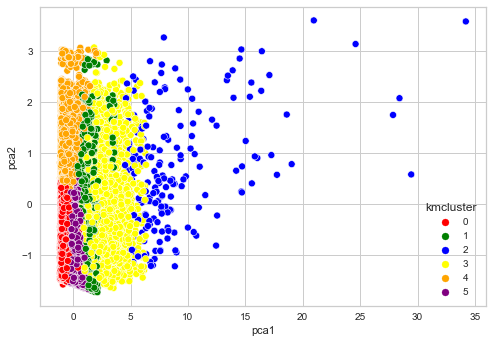

In [43]:
sns.scatterplot(x='pca1', y='pca2', hue='kmcluster', data=pca_df, 
                palette=['red', 'green', 'blue', 'yellow','orange','purple']);

#### TSNE for  KMeans

In [44]:
tsne=TSNE(n_components=2, init='pca', perplexity= 35, random_state=42,learning_rate='auto')

In [45]:
tsne=tsne.fit_transform(rfm_std)

/Users/sanjibansantra/opt/anaconda3/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:996: FutureWarning:

The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.



In [46]:
tsne_df=pd.DataFrame(data=tsne, columns=['tsne1','tsne2'])

In [47]:
tsne_df=pd.concat([tsne_df, RFM['kmcluster']], axis=1)
tsne_df.head()

,tsne1,tsne2,kmcluster
0,22.373756,-60.904842,5
1,-106.958519,-62.582378,0
2,9.602822,120.541702,4
3,-78.205269,57.113075,4
4,46.816292,31.346758,5


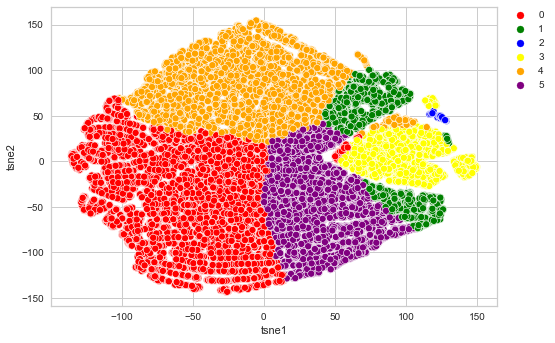

In [48]:
sns.scatterplot(x='tsne1', y='tsne2', hue='kmcluster', data=tsne_df, 
                palette=['red', 'green', 'blue', 'yellow','orange','purple'])
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0);

#### K-Proptotype Clustering

K-Prototype is a clustering method based on partitioning. The algorithm is an improvement of the K-Means and K-Mode clustering algorithm to handle clustering with mixed data types. 

In [49]:
last_date = df['order_delivered_carrier_date'].max() + timedelta(days=1)
RFMP = df.groupby(['customer_unique_id', 'payment_type']).agg({
    'order_delivered_carrier_date': lambda x: (last_date - x.max()).days,
    'order_id': lambda x: len(x),
    'payment_value': 'sum'
})

In [50]:
RFMP.reset_index(inplace=True)

In [51]:
RFMP.columns=['customer_unique_id', 'payment_type', 'Recency', 'Frequency', 'MonetaryValue']
RFMP.head()

,customer_unique_id,payment_type,Recency,Frequency,MonetaryValue
0,0000366f3b9a7992bf8c76cfdf3221e2,credit_card,123,1,141.90
1,0000b849f77a49e4a4ce2b2a4ca5be3f,credit_card,126,1,27.19
2,0000f46a3911fa3c0805444483337064,credit_card,548,1,86.22
3,0000f6ccb0745a6a4b88665a16c9f078,credit_card,333,1,43.62
4,0004aac84e0df4da2b147fca70cf8255,credit_card,299,1,196.89


In [52]:
q1_mv = RFMP['MonetaryValue'].quantile(0.25)
q3_mv = RFMP['MonetaryValue'].quantile(0.75)
IQR = q3_mv - q1_mv
RFMP = RFMP[(RFMP['MonetaryValue'] > q1_mv - 1.5*IQR) & (RFMP['MonetaryValue'] < q3_mv + 1.5*IQR)]

In [53]:
RFMP.isnull().any()

customer_unique_id    False
payment_type          False
Recency               False
Frequency             False
MonetaryValue         False
dtype: bool

In [54]:
for c in RFMP.select_dtypes(exclude='object').columns:
    std = StandardScaler()
    RFMP[c] =  std.fit_transform(np.array(RFMP[c]).reshape(-1, 1))

In [55]:
kproto = KPrototypes(n_clusters= 6, init='Cao', n_jobs = -1)
kcluster = kproto.fit(RFMP, categorical=[0, 1])

In [56]:
labels = kcluster.labels_
pd.Series(labels).value_counts()

3    24949
4    24082
5    16728
1    13512
2     6901
0      316
dtype: int64

In [57]:
last_date = df['order_delivered_carrier_date'].max() + timedelta(days=1)
RFMP1 = df.groupby(['customer_unique_id', 'payment_type']).agg({
    'order_delivered_carrier_date': lambda x: (last_date - x.max()).days,
    'order_id': lambda x: len(x),
    'payment_value': 'sum'
})

In [58]:
RFMP1.reset_index(inplace=True)

In [59]:
RFMP1.columns=['customer_unique_id', 'payment_type', 'Recency', 'Frequency', 'MonetaryValue']
RFMP1.head()

,customer_unique_id,payment_type,Recency,Frequency,MonetaryValue
0,0000366f3b9a7992bf8c76cfdf3221e2,credit_card,123,1,141.90
1,0000b849f77a49e4a4ce2b2a4ca5be3f,credit_card,126,1,27.19
2,0000f46a3911fa3c0805444483337064,credit_card,548,1,86.22
3,0000f6ccb0745a6a4b88665a16c9f078,credit_card,333,1,43.62
4,0004aac84e0df4da2b147fca70cf8255,credit_card,299,1,196.89


In [60]:
q1_mv = RFMP1['MonetaryValue'].quantile(0.25)
q3_mv = RFMP1['MonetaryValue'].quantile(0.75)
IQR = q3_mv - q1_mv
RFMP1 = RFMP1[(RFMP1['MonetaryValue'] > q1_mv - 1.5*IQR) & (RFMP1['MonetaryValue'] < q3_mv + 1.5*IQR)]

In [61]:
RFMP1.shape

(86488, 5)

In [62]:
RFMP.shape

(86488, 5)

In [63]:
RFMP1['kpcluster']= kcluster.labels_

In [64]:
RFMP1.head()

,customer_unique_id,payment_type,Recency,Frequency,MonetaryValue,kpcluster
0,0000366f3b9a7992bf8c76cfdf3221e2,credit_card,123,1,141.90,3
1,0000b849f77a49e4a4ce2b2a4ca5be3f,credit_card,126,1,27.19,3
2,0000f46a3911fa3c0805444483337064,credit_card,548,1,86.22,5
3,0000f6ccb0745a6a4b88665a16c9f078,credit_card,333,1,43.62,4
4,0004aac84e0df4da2b147fca70cf8255,credit_card,299,1,196.89,1


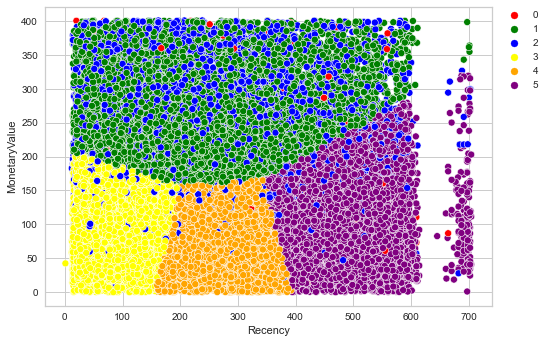

In [65]:
sns.scatterplot(x='Recency', y='MonetaryValue', hue= 'kpcluster', data=RFMP1,
                palette=['red', 'green', 'blue', 'yellow', 'orange', 'purple'])
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)

In [66]:
px.scatter_3d(RFMP1, x='Recency', y='Frequency', z='MonetaryValue', color='kpcluster')

In [67]:
RFMP2= RFMP1.drop(columns=['customer_unique_id', 'payment_type', 'kpcluster'])

In [68]:
RFMP2_std = std.fit_transform(RFMP2)

In [69]:
kproto_score = silhouette_score(RFMP2_std, kcluster.labels_, metric='euclidean')
round(kproto_score, 4)

0.3435

#### PCA  for K-Prototype

In [70]:
pca=PCA(n_components=2)
principal_comp=pca.fit_transform(RFMP2_std)
principal_comp

array([[ 0.01327361, -0.85096486],
       [-0.95379695, -0.76684598],
       [-0.47680378,  1.962916  ],
       ...,
       [-0.2572291 ,  2.16422626],
       [-0.05636997, -0.78742481],
       [-0.59784031,  1.6306989 ]])

In [71]:
pca_df=pd.DataFrame(data=principal_comp,columns=['pca1','pca2'])
pca_df.head()

,pca1,pca2
0,0.013274,-0.850965
1,-0.953797,-0.766846
2,-0.476804,1.962916
3,-0.825403,0.579201
4,0.468214,0.270443


In [72]:
pca_df=pd.concat([pca_df, RFMP1['kpcluster']], axis=1)
pca_df.head()

,pca1,pca2,kpcluster
0,0.013274,-0.850965,3.0
1,-0.953797,-0.766846,3.0
2,-0.476804,1.962916,5.0
3,-0.825403,0.579201,4.0
4,0.468214,0.270443,1.0


<AxesSubplot:xlabel='pca1', ylabel='pca2'>

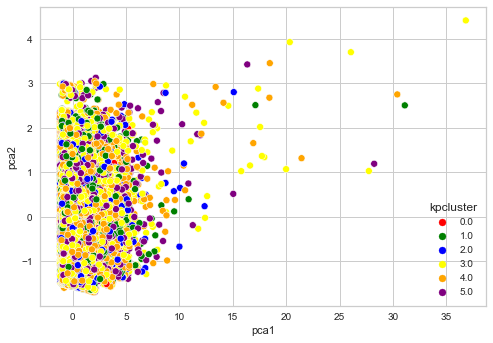

In [73]:
sns.scatterplot(x='pca1', y='pca2', hue='kpcluster', data=pca_df, 
                palette=['red', 'green', 'blue', 'yellow','orange','purple'])

#### TSNE for KPrototype

In [74]:
tsne=TSNE(n_components=2, init='pca', perplexity= 35, random_state=42, learning_rate='auto')

In [75]:
tsne=tsne.fit_transform(RFMP2_std)

/Users/sanjibansantra/opt/anaconda3/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:996: FutureWarning:

The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.



In [76]:
tsne_df=pd.DataFrame(data=tsne, columns=['tsne1','tsne2'])

In [77]:
tsne_df=pd.concat([tsne_df, RFMP1['kpcluster']], axis=1)
tsne_df.head()

,tsne1,tsne2,kpcluster
0,28.007854,-60.539433,3.0
1,-108.369835,-64.313599,3.0
2,9.307053,121.540085,5.0
3,-79.971008,55.260685,4.0
4,53.358345,31.315617,1.0


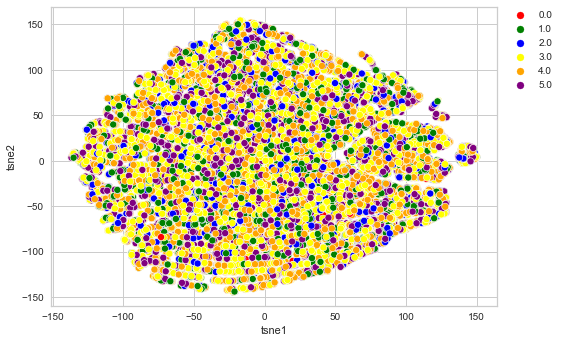

In [78]:
sns.scatterplot(x='tsne1', y='tsne2', hue='kpcluster', data=tsne_df, 
                palette=['red', 'green', 'blue', 'yellow','orange','purple'])
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
plt.show()

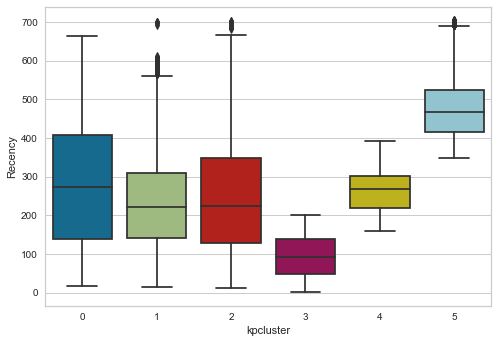

In [79]:
sns.boxplot(x='kpcluster', y='Recency', data=RFMP1);

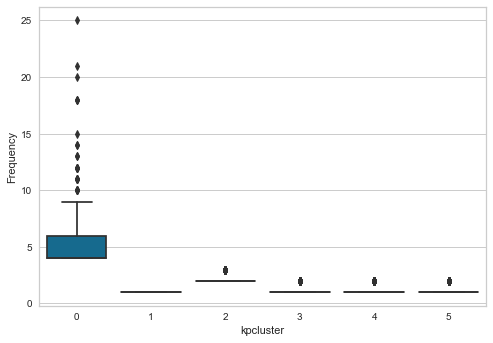

In [80]:
sns.boxplot(x='kpcluster', y='Frequency', data=RFMP1);

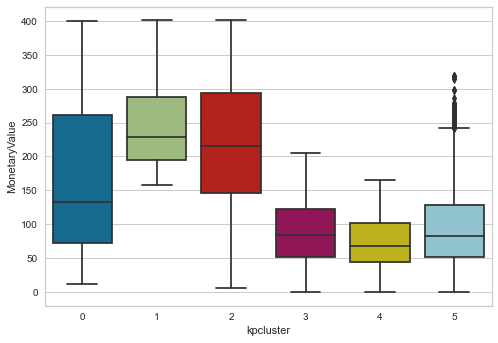

In [81]:
sns.boxplot(x='kpcluster', y='MonetaryValue', data=RFMP1);

#### DBSCAN Clustering

DBSCAN groups ‘densely grouped’ data points into a single cluster. It can identify clusters in large spatial datasets by looking at the local density of the data points. 

* The most exciting feature of DBSCAN clustering is that it is robust to outliers. 

* It also does not require the number of clusters to be told beforehand, unlike K-Means.

DBSCAN requires only two parameters: epsilon and minPoints. 

* Epsilon is the radius of the circle to be created around each data point to check the density 
* minPoints is the minimum number of data points required inside that circle for that data point to be classified as a Core point.

In [82]:
last_date = df['order_delivered_carrier_date'].max() + timedelta(days=1)
RFMDB = df.groupby('customer_unique_id').agg({
    'order_delivered_carrier_date': lambda x: (last_date - x.max()).days,
    'order_id': lambda x: len(x),
    'payment_value': 'sum'
})

In [83]:
RFMDB.columns=['Recency', 'Frequency', 'MonetaryValue']
RFMDB.head()

,Recency,Frequency,MonetaryValue
customer_unique_id,,,
0000366f3b9a7992bf8c76cfdf3221e2,123,1,141.90
0000b849f77a49e4a4ce2b2a4ca5be3f,126,1,27.19
0000f46a3911fa3c0805444483337064,548,1,86.22
0000f6ccb0745a6a4b88665a16c9f078,333,1,43.62
0004aac84e0df4da2b147fca70cf8255,299,1,196.89


In [84]:
q1_mv = RFMDB['MonetaryValue'].quantile(0.25)
q3_mv = RFMDB['MonetaryValue'].quantile(0.75)
IQR = q3_mv - q1_mv
RFMP1 = RFMDB[(RFMDB['MonetaryValue'] > q1_mv - 1.5*IQR) & (RFMDB['MonetaryValue'] < q3_mv + 1.5*IQR)]

In [85]:
std = StandardScaler()
rfmdb_std = std.fit_transform(RFMDB)

In [86]:
from sklearn.neighbors import NearestNeighbors

In [87]:
neighbors = NearestNeighbors(n_neighbors=100)
neighbors_fit = neighbors.fit(rfmdb_std)
distances, indices = neighbors_fit.kneighbors(rfmdb_std)

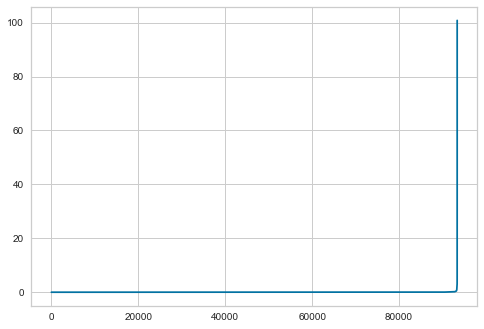

In [88]:
distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.plot(distances)
plt.show()

In [89]:
dbscan=DBSCAN(eps=0.5, min_samples=100)

In [90]:
dbs=dbscan.fit(rfmdb_std)

In [91]:
RFMDB['dbcluster'] = dbs.labels_

In [92]:
RFMDB['dbcluster'].value_counts()

 0    79088
 1    10212
-1     2019
 3     1668
 2      355
Name: dbcluster, dtype: int64

In [93]:
RFMDB.head()

,Recency,Frequency,MonetaryValue,dbcluster
customer_unique_id,,,,
0000366f3b9a7992bf8c76cfdf3221e2,123,1,141.90,0
0000b849f77a49e4a4ce2b2a4ca5be3f,126,1,27.19,0
0000f46a3911fa3c0805444483337064,548,1,86.22,0
0000f6ccb0745a6a4b88665a16c9f078,333,1,43.62,0
0004aac84e0df4da2b147fca70cf8255,299,1,196.89,0


In [94]:
RFMDB.reset_index(inplace=True)

In [95]:
px.scatter_3d(RFMDB, x='Recency', y='Frequency', z='MonetaryValue', color='dbcluster')

#### TSNE for DBSCAN

In [96]:
tsne=TSNE(n_components=2, init='pca', perplexity= 35, random_state=42, learning_rate='auto')

In [97]:
tsne=tsne.fit_transform(rfmdb_std)

/Users/sanjibansantra/opt/anaconda3/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:996: FutureWarning:

The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.



In [98]:
tsne_df=pd.DataFrame(data=tsne, columns=['tsne1','tsne2'])

In [99]:
tsne_df=pd.concat([tsne_df, RFMDB['dbcluster']], axis=1)
tsne_df.head()

,tsne1,tsne2,dbcluster
0,12.405123,-54.789997,0
1,-109.164230,-71.459641,0
2,14.342464,144.477722,0
3,-28.272192,49.561592,0
4,35.424088,40.822659,0


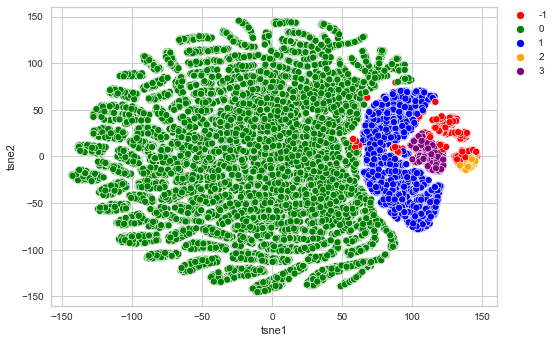

In [100]:
sns.scatterplot(x='tsne1', y='tsne2', hue='dbcluster', palette=['red', 'green', 'blue','orange','purple'], 
                data=tsne_df);
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)

In [101]:
dbscan_score = silhouette_score(rfmdb_std, dbs.labels_, metric='euclidean')
round(dbscan_score, 4)

0.3354

In [102]:
data = {'Model': ['KMeans', 'KPrototype', 'DBSCAN'], 
        'SilhoutteScore': [kmeans_score, kproto_score, dbscan_score]}  
df_silhoutte=pd.DataFrame(data)

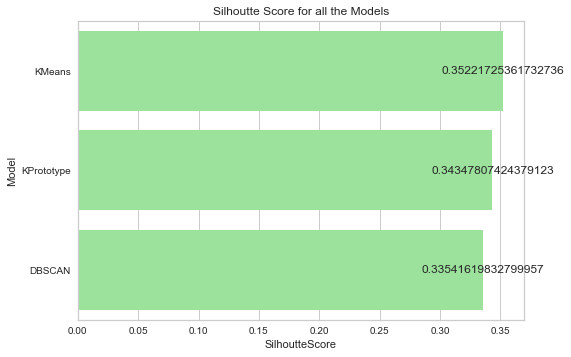

In [103]:
s=sns.barplot(x="SilhoutteScore",y="Model",color='lightgreen', data=df_silhoutte, order=df_silhoutte.sort_values('SilhoutteScore',ascending = False).Model)
for p in s.patches:
    s.annotate(p.get_width(), xy=(p.get_width(), p.get_y()+p.get_height()/2),
            xytext=(0, 0), textcoords='offset points',ha='center', va="center")
    s.set_title('Silhoutte Score for all the Models')

### Since K-Means algo is less time consuming. We choose the KMean algorithm.

**Adjusted RAND index (ARI) for K-Means model (To check the stability)**

Hypothesis: We will cosider a model bad if its ARI falls bellow 0.5.

Now we check the stability of the KMeans model.

In [104]:
last_date = df['order_delivered_carrier_date'].max() + timedelta(days=1)
RFM = df.groupby('customer_unique_id').agg({
    'order_delivered_carrier_date': lambda x: (last_date - x.max()).days,
    'order_id': lambda x: len(x),
    'payment_value': 'sum'
})

In [105]:
RFM.columns=['Recency', 'Frequency','MonetaryValue']

Consider the year 2018, January to June period. 

In [106]:
periods = [
           "2018-01-01", "2018-02-01", 
           "2018-03-01", "2018-04-01", 
           "2018-05-01", "2018-06-01", 
           ]

In [107]:
# Create a list 

rfm_clusters = []
for d in periods:
  last_date = datetime.strptime(d, "%Y-%m-%d") + timedelta(days=1)
  RFM = df[df['order_delivered_carrier_date']<=d].groupby(
      'customer_unique_id').agg({
          'order_delivered_carrier_date': lambda x: (last_date - x.max()).days,
          'order_id': lambda x: len(x),
          'payment_value': 'sum'
  })
      
  RFM.columns=['Recency','Frequency','MonetaryValue']

  std = StandardScaler()
  rfm_std = std.fit_transform(RFM)

  model = KMeans(n_clusters=6)
  kmeans = model.fit(rfm_std)
  RFM['kmcluster'] = kmeans.labels_

  rfm_clusters.append(RFM)

In [108]:
rfm_clusters[0]

,Recency,Frequency,MonetaryValue,kmcluster
customer_unique_id,,,,
0000f46a3911fa3c0805444483337064,294,1,86.22,3
0000f6ccb0745a6a4b88665a16c9f078,80,1,43.62,1
0004aac84e0df4da2b147fca70cf8255,46,1,196.89,1
0005e1862207bf6ccc02e4228effd9a0,301,1,150.12,3
0006fdc98a402fceb4eb0ee528f6a8d4,164,1,29.00,5
...,...,...,...,...
fffb09418989a0dbff854a28163e47c6,13,1,73.16,1
fffcf5a5ff07b0908bd4e2dbc735a684,192,2,4134.84,0
fffea47cd6d3cc0a88bd621562a9d061,11,1,84.58,1


In [109]:
indices = rfm_clusters[0].index

In [110]:
# Define a create a list of ARI scores
ari_scores = []
for r in range(len(rfm_clusters)):
  first_month = rfm_clusters[0]['kmcluster']
  second_month = pd.DataFrame(rfm_clusters[r], index=indices)['kmcluster']
  ari = adjusted_rand_score(first_month, second_month)
  ari_scores.append(ari)
print(ari_scores)

[1.0, 0.7785910530353768, 0.5762756371751414, 0.5466617093890095, 0.5168464906605711, 0.4070788563024667]


In [111]:
aris_df = pd.DataFrame.from_dict({"date": periods, "score": ari_scores})
print(aris_df)

         date     score
0  2018-01-01  1.000000
1  2018-02-01  0.778591
2  2018-03-01  0.576276
3  2018-04-01  0.546662
4  2018-05-01  0.516846
5  2018-06-01  0.407079


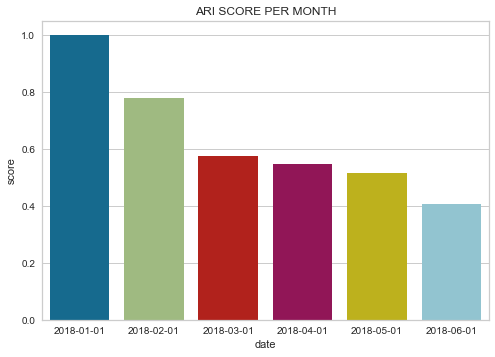

In [112]:
sns.barplot(x='date', y='score', data=aris_df).set_title('ARI SCORE PER MONTH');

## So before 01-06-2018 the model needs to be updated as the performance score goes below 0.5.